# 🎬 Mini-Movie Rendering with gsplat (Colab Optimized)

**Environment**: Google Colab Pro with GPU  
**Date**: 2025-12-09  
**Goal**: Render 11-second mini-movie from trajectory JSON and PLY files

---

## ⚠️ IMPORTANT: GPU Runtime Required

Before running this notebook:
1. Go to **Runtime → Change runtime type**
2. Set **Hardware accelerator** to **GPU** (T4, V100, or A100)
3. Click **Save**

---

# Part 0: Environment Setup

In [1]:
# Cell 0.1: Verify GPU and CUDA

import torch
import subprocess

print("="*70)
print("ENVIRONMENT CHECK")
print("="*70)

# Check PyTorch
print(f"\nPyTorch version: {torch.__version__}")
print(f"CUDA available: {torch.cuda.is_available()}")

if torch.cuda.is_available():
    print(f"CUDA version (PyTorch): {torch.version.cuda}")
    print(f"GPU device: {torch.cuda.get_device_name(0)}")
    print(f"GPU memory: {torch.cuda.get_device_properties(0).total_memory / 1e9:.2f} GB")
else:
    print("\n❌ ERROR: CUDA not available!")
    print("Please go to Runtime → Change runtime type → GPU")
    raise RuntimeError("GPU runtime required")

# Check nvcc
try:
    result = subprocess.run(['nvcc', '--version'], capture_output=True, text=True)
    print(f"\nnvcc available: ✓")
    print(result.stdout.split('\n')[-2])  # Version line
except FileNotFoundError:
    print("\n⚠️ Warning: nvcc not found, but will try gsplat installation anyway")

print("\n✓ Environment check complete")

ENVIRONMENT CHECK

PyTorch version: 2.9.0+cu126
CUDA available: True
CUDA version (PyTorch): 12.6
GPU device: NVIDIA L4
GPU memory: 23.80 GB

nvcc available: ✓
Build cuda_12.5.r12.5/compiler.34385749_0

✓ Environment check complete


In [2]:
# Cell 0.2: Install Dependencies

print("Installing dependencies...\n")

# Install gsplat (will JIT compile CUDA kernels on first use)
!pip install -q gsplat plyfile imageio imageio-ffmpeg tqdm

print("\n✓ All dependencies installed")
print("\nNote: gsplat will compile CUDA kernels on first render (takes ~1-2 min)")

Installing dependencies...

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 6.5/6.5 MB 50.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.9/55.9 kB 4.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 180.7/180.7 kB 13.6 MB/s eta 0:00:00

✓ All dependencies installed

Note: gsplat will compile CUDA kernels on first render (takes ~1-2 min)


In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [6]:
# Cell 0.3: Upload Files to Colab

from google.colab import files
import os

print("="*70)
print("FILE UPLOAD")
print("="*70)

print("\nPlease upload the following files:")
print("  1. trajectory_story.json")
print("  2. point_cloud_scene_pinhole.ply (or your scene PLY)")
print("  3. point_cloud_kermit_pinhole.ply (or your object1 PLY)")
print("  4. point_cloud_jimbeam.ply (or your object2 PLY)")

print("\nUploading files...")
uploaded = files.upload()

print(f"\n✓ Uploaded {len(uploaded)} file(s):")
for filename in uploaded.keys():
    print(f"  - {filename} ({os.path.getsize(filename) / 1024:.1f} KB)")

FILE UPLOAD

Please upload the following files:
  1. trajectory_story.json
  2. point_cloud_scene_pinhole.ply (or your scene PLY)
  3. point_cloud_kermit_pinhole.ply (or your object1 PLY)
  4. point_cloud_jimbeam.ply (or your object2 PLY)

Uploading files...


KeyboardInterrupt: 

# Part 1: Configuration

In [23]:
# Cell 1.1: Imports

import numpy as np
import torch
import json
from pathlib import Path
from typing import Dict, List, Tuple
import matplotlib.pyplot as plt
from tqdm import tqdm
import imageio

from plyfile import PlyData
from gsplat import rasterization

# Set device
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {DEVICE}")

Using device: cuda


In [51]:
# Cell 1.2: File Paths Configuration

# 🔧 UPDATE THESE PATHS to match your uploaded filenames
TRAJECTORY_JSON = Path("/content/drive/MyDrive/25_sch/CV/Ass3/3dgs_outputs/please/trajectory_story_tilt.json")

PLY_PATHS = {
    "scene": Path("/content/drive/MyDrive/25_sch/CV/Ass3/3dgs_outputs/please/aligned_scene.ply"),
    "obj01": Path("/content/drive/MyDrive/25_sch/CV/Ass3/3dgs_outputs/please/aligned_obj01_kermit.ply"),
    "obj02": Path("/content/drive/MyDrive/25_sch/CV/Ass3/3dgs_outputs/please/aligned_obj02_bottle.ply"),
}

# Output configuration
OUTPUT_DIR = Path("output_video")
FRAMES_DIR = OUTPUT_DIR / "frames"
VIDEO_PATH = OUTPUT_DIR / "minimovie_final.mp4"

# Create directories
FRAMES_DIR.mkdir(parents=True, exist_ok=True)

print("="*70)
print("FILE PATHS CONFIGURATION")
print("="*70)

print(f"\nTrajectory JSON: {TRAJECTORY_JSON}")
print(f"  Exists: {'✓' if TRAJECTORY_JSON.exists() else '✗ MISSING'}")

print(f"\nPLY Files:")
for name, path in PLY_PATHS.items():
    status = "✓" if path.exists() else "✗ MISSING"
    print(f"  [{status}] {name}: {path}")

print(f"\nOutput:")
print(f"  Frames directory: {FRAMES_DIR}")
print(f"  Final video: {VIDEO_PATH}")

# Verify all files exist
missing = []
if not TRAJECTORY_JSON.exists():
    missing.append(str(TRAJECTORY_JSON))
for name, path in PLY_PATHS.items():
    if not path.exists():
        missing.append(f"{name}: {path}")

if missing:
    print(f"\n❌ ERROR: Missing files:")
    for f in missing:
        print(f"  - {f}")
    raise FileNotFoundError("Please upload all required files")

print("\n✓ All files found")

FILE PATHS CONFIGURATION

Trajectory JSON: /content/drive/MyDrive/25_sch/CV/Ass3/3dgs_outputs/please/trajectory_story_tilt.json
  Exists: ✓

PLY Files:
  [✓] scene: /content/drive/MyDrive/25_sch/CV/Ass3/3dgs_outputs/please/aligned_scene.ply
  [✓] obj01: /content/drive/MyDrive/25_sch/CV/Ass3/3dgs_outputs/please/aligned_obj01_kermit.ply
  [✓] obj02: /content/drive/MyDrive/25_sch/CV/Ass3/3dgs_outputs/please/aligned_obj02_bottle.ply

Output:
  Frames directory: output_video/frames
  Final video: output_video/minimovie_final.mp4

✓ All files found


# Part 2: Load Data

In [52]:
# Cell 2.1: Load Trajectory JSON

print("Loading trajectory JSON...")

with open(TRAJECTORY_JSON, 'r') as f:
    trajectory_data = json.load(f)

# Extract metadata
metadata = trajectory_data['metadata']
FPS = metadata['fps']
N_FRAMES = metadata['n_frames']
DURATION = metadata['duration_sec']
WIDTH, HEIGHT = metadata['resolution']
FOV_DEG = metadata['fov_degrees']

# Extract trajectories
camera_frames = trajectory_data['camera']['frames']
obj01_frames = trajectory_data['objects']['obj01']['frames']
obj02_frames = trajectory_data['objects']['obj02']['frames']

print("\n" + "="*70)
print("TRAJECTORY SUMMARY")
print("="*70)
print(f"Duration: {DURATION}s @ {FPS} fps = {N_FRAMES} frames")
print(f"Resolution: {WIDTH}x{HEIGHT}")
print(f"FOV: {FOV_DEG}°")
print(f"\nTrajectories loaded:")
print(f"  Camera: {len(camera_frames)} frames")
print(f"  Obj01: {len(obj01_frames)} frames")
print(f"  Obj02: {len(obj02_frames)} frames")

# Verify consistency
assert len(camera_frames) == N_FRAMES, "Camera frame count mismatch"
assert len(obj01_frames) == N_FRAMES, "Obj01 frame count mismatch"
assert len(obj02_frames) == N_FRAMES, "Obj02 frame count mismatch"
print("\n✓ All frame counts consistent")

Loading trajectory JSON...

TRAJECTORY SUMMARY
Duration: 11.0s @ 30 fps = 330 frames
Resolution: 960x540
FOV: 50.0°

Trajectories loaded:
  Camera: 330 frames
  Obj01: 330 frames
  Obj02: 330 frames

✓ All frame counts consistent


In [40]:
# Cell 2.2: PLY Loading Function

def load_gaussian_ply(ply_path: Path, device: torch.device) -> Dict[str, torch.Tensor]:
    """
    Load 3DGS PLY file and return Gaussian parameters as PyTorch tensors.
    """
    plydata = PlyData.read(str(ply_path))
    vertex = plydata['vertex']

    # Extract positions (means)
    means = np.stack([vertex['x'], vertex['y'], vertex['z']], axis=1).astype(np.float32)

    # Extract opacities
    opacities = vertex['opacity'].astype(np.float32)

    # Extract scales (log-space)
    scale_names = sorted([p.name for p in vertex.properties if p.name.startswith("scale_")])
    scales = np.stack([vertex[name] for name in scale_names], axis=1).astype(np.float32)

    # Extract rotations (quaternions)
    rot_names = sorted([p.name for p in vertex.properties if p.name.startswith("rot_")])
    quats = np.stack([vertex[name] for name in rot_names], axis=1).astype(np.float32)

    # Normalize quaternions
    quats = quats / (np.linalg.norm(quats, axis=1, keepdims=True) + 1e-8)

    # Extract spherical harmonics
    sh0 = np.stack([vertex[f'f_dc_{i}'] for i in range(3)], axis=1).astype(np.float32)

    extra_f_names = sorted([p.name for p in vertex.properties if p.name.startswith("f_rest_")])
    if len(extra_f_names) > 0:
        shN = np.stack([vertex[name] for name in extra_f_names], axis=1).astype(np.float32)
    else:
        shN = np.zeros((means.shape[0], 0), dtype=np.float32)

    # Convert to PyTorch tensors
    return {
        'means': torch.from_numpy(means).to(device),
        'scales': torch.from_numpy(scales).to(device),
        'quats': torch.from_numpy(quats).to(device),
        'opacities': torch.from_numpy(opacities).to(device),
        'sh0': torch.from_numpy(sh0).to(device),
        'shN': torch.from_numpy(shN).to(device),
    }

print("✓ PLY loading function defined")

✓ PLY loading function defined


In [28]:
# Cell 2.3: Load All PLY Files

print("Loading PLY files to GPU...\n")

scene_gs = load_gaussian_ply(PLY_PATHS["scene"], DEVICE)
obj01_gs = load_gaussian_ply(PLY_PATHS["obj01"], DEVICE)
obj02_gs = load_gaussian_ply(PLY_PATHS["obj02"], DEVICE)

print(f"Scene: {scene_gs['means'].shape[0]:,} Gaussians")
print(f"Obj01: {obj01_gs['means'].shape[0]:,} Gaussians")
print(f"Obj02: {obj02_gs['means'].shape[0]:,} Gaussians")
print(f"\nTotal: {scene_gs['means'].shape[0] + obj01_gs['means'].shape[0] + obj02_gs['means'].shape[0]:,} Gaussians")

print("\n✓ All PLY files loaded to GPU")

Loading PLY files to GPU...

Scene: 1,508,976 Gaussians
Obj01: 108,077 Gaussians
Obj02: 71,268 Gaussians

Total: 1,688,321 Gaussians

✓ All PLY files loaded to GPU


# Part 3: Transformation Utilities

In [41]:
# Cell 3.1: Quaternion Math

def quaternion_multiply(q1: torch.Tensor, q2: torch.Tensor) -> torch.Tensor:
    """
    Multiply two quaternions [w, x, y, z].
    """
    w1, x1, y1, z1 = q1[..., 0], q1[..., 1], q1[..., 2], q1[..., 3]
    w2, x2, y2, z2 = q2[..., 0], q2[..., 1], q2[..., 2], q2[..., 3]

    w = w1*w2 - x1*x2 - y1*y2 - z1*z2
    x = w1*x2 + x1*w2 + y1*z2 - z1*y2
    y = w1*y2 - x1*z2 + y1*w2 + z1*x2
    z = w1*z2 + x1*y2 - y1*x2 + z1*w2

    return torch.stack([w, x, y, z], dim=-1)

def quaternion_rotate_point(points: torch.Tensor, quat: torch.Tensor) -> torch.Tensor:
    """
    Rotate points by quaternion.
    points: [N, 3]
    quat: [4] - [w, x, y, z]
    """
    point_quat = torch.cat([torch.zeros(points.shape[0], 1, device=points.device), points], dim=1)
    quat_conj = torch.tensor([quat[0], -quat[1], -quat[2], -quat[3]], device=quat.device)

    rotated = quaternion_multiply(quat.unsqueeze(0), point_quat)
    rotated = quaternion_multiply(rotated, quat_conj.unsqueeze(0))

    return rotated[:, 1:]

print("✓ Quaternion functions defined")

✓ Quaternion functions defined


In [42]:
# Cell 3.2: Object Transformation

def apply_object_transform(
    gaussians: Dict[str, torch.Tensor],
    translation: torch.Tensor,
    rotation_quat: torch.Tensor,
    scale: float
) -> Dict[str, torch.Tensor]:
    """
    Apply rigid transformation (translation, rotation, scale) to Gaussians.
    """
    # Transform positions
    means_rotated = quaternion_rotate_point(gaussians['means'], rotation_quat)
    means_transformed = means_rotated * scale + translation

    # Scale the Gaussian sizes (scales are in log-space)
    scales_transformed = gaussians['scales'] + np.log(scale)

    # Rotate the Gaussian orientations
    quats_transformed = quaternion_multiply(rotation_quat.unsqueeze(0), gaussians['quats'])
    quats_transformed = quats_transformed / (torch.norm(quats_transformed, dim=1, keepdim=True) + 1e-8)

    return {
        'means': means_transformed,
        'scales': scales_transformed,
        'quats': quats_transformed,
        'opacities': gaussians['opacities'],
        'sh0': gaussians['sh0'],
        'shN': gaussians['shN'],
    }

print("✓ Transformation function defined")

✓ Transformation function defined


# Part 4: Camera Utilities

In [43]:
# Cell 4.1: Camera Matrix Functions

def quaternion_to_rotation_matrix(quat: torch.Tensor) -> torch.Tensor:
    """
    Convert quaternion [w, x, y, z] to 3x3 rotation matrix.
    """
    w, x, y, z = quat[0], quat[1], quat[2], quat[3]

    R = torch.stack([
        torch.stack([1-2*(y*y+z*z), 2*(x*y-w*z), 2*(x*z+w*y)]),
        torch.stack([2*(x*y+w*z), 1-2*(x*x+z*z), 2*(y*z-w*x)]),
        torch.stack([2*(x*z-w*y), 2*(y*z+w*x), 1-2*(x*x+y*y)])
    ])

    return R

def build_view_matrix(camera_position: torch.Tensor, rotation_quat: torch.Tensor) -> torch.Tensor:
    """
    Build 4x4 view matrix from camera pose.
    """
    R = quaternion_to_rotation_matrix(rotation_quat)
    t = camera_position

    # View matrix is inverse of camera pose
    R_T = R.T
    t_view = -R_T @ t

    view_matrix = torch.eye(4, device=R.device)
    view_matrix[:3, :3] = R_T
    view_matrix[:3, 3] = t_view

    return view_matrix

def focal_from_fov(fov_degrees: float, image_size: int) -> float:
    """
    Calculate focal length in pixels from FOV.
    """
    return image_size / (2 * np.tan(np.deg2rad(fov_degrees) / 2))

print("✓ Camera functions defined")

✓ Camera functions defined


In [44]:
# Cell 4.2: Camera Intrinsics

fx = focal_from_fov(FOV_DEG, WIDTH)
fy = focal_from_fov(FOV_DEG, HEIGHT)
cx = WIDTH / 2.0
cy = HEIGHT / 2.0

K = torch.tensor([
    [fx, 0, cx],
    [0, fy, cy],
    [0, 0, 1]
], dtype=torch.float32, device=DEVICE)

print("="*70)
print("CAMERA INTRINSICS")
print("="*70)
print(f"Resolution: {WIDTH}x{HEIGHT}")
print(f"FOV: {FOV_DEG}°")
print(f"Focal: fx={fx:.2f}, fy={fy:.2f} pixels")
print(f"Principal point: cx={cx:.2f}, cy={cy:.2f}")
print(f"\nIntrinsic matrix K:")
print(K.cpu().numpy())

CAMERA INTRINSICS
Resolution: 960x540
FOV: 50.0°
Focal: fx=1029.36, fy=579.02 pixels
Principal point: cx=480.00, cy=270.00

Intrinsic matrix K:
[[1.0293633e+03 0.0000000e+00 4.8000000e+02]
 [0.0000000e+00 5.7901685e+02 2.7000000e+02]
 [0.0000000e+00 0.0000000e+00 1.0000000e+00]]


# Part 5: Rendering

In [45]:
# Cell 5.1: Render Single Frame Function

def render_frame(
    scene_gs: Dict[str, torch.Tensor],
    obj01_gs: Dict[str, torch.Tensor],
    obj02_gs: Dict[str, torch.Tensor],
    obj01_transform: Dict,
    obj02_transform: Dict,
    camera_pose: Dict,
    width: int,
    height: int,
    K: torch.Tensor,
    device: torch.device
) -> np.ndarray:
    """
    Render a single frame with scene and transformed objects.

    Returns:
        RGB image as numpy array [H, W, 3] with values in [0, 255]
    """
    # Transform objects
    obj01_transformed = apply_object_transform(
        obj01_gs,
        torch.tensor(obj01_transform['translation'], device=device, dtype=torch.float32),
        torch.tensor(obj01_transform['rotation_quat'], device=device, dtype=torch.float32),
        obj01_transform['scale']
    )

    obj02_transformed = apply_object_transform(
        obj02_gs,
        torch.tensor(obj02_transform['translation'], device=device, dtype=torch.float32),
        torch.tensor(obj02_transform['rotation_quat'], device=device, dtype=torch.float32),
        obj02_transform['scale']
    )

    # Combine all Gaussians
    all_means = torch.cat([scene_gs['means'], obj01_transformed['means'], obj02_transformed['means']], dim=0)
    all_scales = torch.cat([scene_gs['scales'], obj01_transformed['scales'], obj02_transformed['scales']], dim=0)
    all_quats = torch.cat([scene_gs['quats'], obj01_transformed['quats'], obj02_transformed['quats']], dim=0)
    all_opacities = torch.cat([scene_gs['opacities'], obj01_transformed['opacities'], obj02_transformed['opacities']], dim=0)
    all_sh0 = torch.cat([scene_gs['sh0'], obj01_transformed['sh0'], obj02_transformed['sh0']], dim=0)
    all_shN = torch.cat([scene_gs['shN'], obj01_transformed['shN'], obj02_transformed['shN']], dim=0)

    # Prepare colors (SH coefficients)
    if all_shN.shape[1] > 0:
        # Reshape shN: [N, rest] → [N, (rest/3), 3]
        n_gaussians = all_shN.shape[0]
        n_rest = all_shN.shape[1] // 3
        all_shN_reshaped = all_shN.reshape(n_gaussians, n_rest, 3)
        all_colors = torch.cat([all_sh0.unsqueeze(1), all_shN_reshaped], dim=1)  # [N, 1+rest/3, 3]
    else:
        all_colors = all_sh0.unsqueeze(1)  # [N, 1, 3] - DC only

    # Build camera matrices
    camera_position = torch.tensor(camera_pose['position'], device=device, dtype=torch.float32)
    camera_quat = torch.tensor(camera_pose['rotation_quat'], device=device, dtype=torch.float32)

    viewmat = build_view_matrix(camera_position, camera_quat)

    # Render with gsplat
    rendered_image, rendered_alpha, info = rasterization(
        means=all_means,
        quats=all_quats / (torch.norm(all_quats, dim=1, keepdim=True) + 1e-8),  # Ensure normalized
        scales=torch.exp(all_scales),  # Convert from log-space
        opacities=torch.sigmoid(all_opacities).squeeze(-1),  # Apply sigmoid, [N]
        colors=all_colors,
        viewmats=viewmat.unsqueeze(0),  # [1, 4, 4]
        Ks=K.unsqueeze(0),  # [1, 3, 3]
        width=width,
        height=height,
        sh_degree=0 if all_colors.shape[1] == 1 else min(3, int(np.sqrt(all_colors.shape[1])) - 1),
    )

    # Convert to numpy image
    image = rendered_image.squeeze(0).clamp(0, 1).cpu().numpy()  # [H, W, 3]
    image = (image * 255).astype(np.uint8)

    return image

print("✓ Rendering function defined")

✓ Rendering function defined


In [53]:
# Cell 5.2: Render All Frames

print("\n" + "="*70)
print("RENDERING MINI-MOVIE")
print("="*70)
print(f"\nRendering {N_FRAMES} frames...")
print(f"Output: {FRAMES_DIR}")
print(f"\n⏳ This will take a few minutes...")
print(f"Note: First frame will be slower due to CUDA kernel compilation\n")

# Render loop with progress bar
for frame_idx in tqdm(range(N_FRAMES), desc="Rendering"):
    try:
        # Get frame data
        camera_data = camera_frames[frame_idx]
        obj01_data = obj01_frames[frame_idx]
        obj02_data = obj02_frames[frame_idx]

        # Render frame
        image = render_frame(
            scene_gs=scene_gs,
            obj01_gs=obj01_gs,
            obj02_gs=obj02_gs,
            obj01_transform=obj01_data,
            obj02_transform=obj02_data,
            camera_pose=camera_data,
            width=WIDTH,
            height=HEIGHT,
            K=K,
            device=DEVICE
        )

        # Save frame
        frame_path = FRAMES_DIR / f"frame_{frame_idx:04d}.png"
        imageio.imwrite(frame_path, image)

    except Exception as e:
        print(f"\n❌ Error rendering frame {frame_idx}: {e}")
        import traceback
        traceback.print_exc()
        break

print(f"\n✓ Rendered {frame_idx + 1} frames")


RENDERING MINI-MOVIE

Rendering 330 frames...
Output: output_video/frames

⏳ This will take a few minutes...
Note: First frame will be slower due to CUDA kernel compilation



Rendering: 100%|██████████| 330/330 [01:05<00:00,  5.04it/s]


✓ Rendered 330 frames


/tmp/ipython-input-1043376754.py:9: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  img = imageio.imread(frame_path)


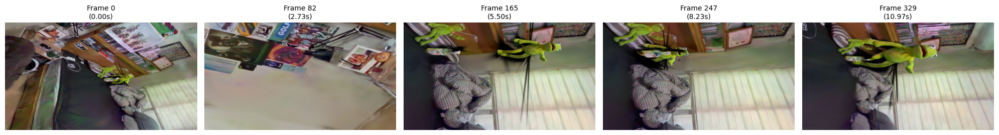

Saved preview: output_video/frame_preview.png


In [54]:
# Cell 5.3: Preview Frames

sample_frames = [0, N_FRAMES//4, N_FRAMES//2, 3*N_FRAMES//4, N_FRAMES-1]

fig, axes = plt.subplots(1, len(sample_frames), figsize=(20, 4))
for i, frame_idx in enumerate(sample_frames):
    frame_path = FRAMES_DIR / f"frame_{frame_idx:04d}.png"
    if frame_path.exists():
        img = imageio.imread(frame_path)
        axes[i].imshow(img)
        axes[i].set_title(f"Frame {frame_idx}\n({frame_idx/FPS:.2f}s)", fontsize=10)
        axes[i].axis('off')

plt.tight_layout()
plt.savefig(OUTPUT_DIR / "frame_preview.png", dpi=100, bbox_inches='tight')
plt.show()

print(f"Saved preview: {OUTPUT_DIR / 'frame_preview.png'}")

# Part 6: Create Video

In [55]:
# Cell 6.1: Combine Frames into Video

print("\n" + "="*70)
print("CREATING VIDEO")
print("="*70)

# Get all frame files
frame_files = sorted(FRAMES_DIR.glob("frame_*.png"))
print(f"\nFound {len(frame_files)} frames")

if len(frame_files) == 0:
    print("❌ ERROR: No frames found!")
else:
    # Read frames
    print("Reading frames...")
    frames = []
    for frame_path in tqdm(frame_files, desc="Loading"):
        frames.append(imageio.imread(frame_path))

    # Write video
    print(f"\nWriting video to {VIDEO_PATH}...")
    imageio.mimwrite(
        VIDEO_PATH,
        frames,
        fps=FPS,
        quality=9,
        codec='libx264',
        pixelformat='yuv420p',
        macro_block_size=1
    )

    print(f"\n✓ Video created: {VIDEO_PATH}")
    print(f"  Duration: {len(frames) / FPS:.2f}s")
    print(f"  FPS: {FPS}")
    print(f"  Resolution: {WIDTH}x{HEIGHT}")
    print(f"  File size: {VIDEO_PATH.stat().st_size / (1024*1024):.2f} MB")


CREATING VIDEO

Found 330 frames
Reading frames...


Loading:   0%|          | 0/330 [00:00<?, ?it/s]/tmp/ipython-input-3995786771.py:18: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  frames.append(imageio.imread(frame_path))
Loading: 100%|██████████| 330/330 [00:06<00:00, 52.66it/s]



Writing video to output_video/minimovie_final.mp4...

✓ Video created: output_video/minimovie_final.mp4
  Duration: 11.00s
  FPS: 30
  Resolution: 960x540
  File size: 17.92 MB


In [57]:
# Cell 6.1.5: Rotate Video 90° Counterclockwise

print("\n" + "="*70)
print("ROTATE VIDEO 90° COUNTERCLOCKWISE")
print("="*70)

import subprocess

# Original video path
original_video = VIDEO_PATH
rotated_video = OUTPUT_DIR / "minimovie_final_rotated_90ccw.mp4"

print(f"\nOriginal video: {original_video}")
print(f"Rotated video: {rotated_video}")
print(f"\n⏳ Rotating video 90° counterclockwise...")

# Use ffmpeg to rotate
# transpose=1: 90° counterclockwise
# transpose=2: 90° clockwise
# transpose=0: 90° counterclockwise + vertical flip
# transpose=3: 90° clockwise + vertical flip

try:
    subprocess.run([
        'ffmpeg',
        '-i', str(original_video),
        '-vf', 'transpose=2',  # 90° counterclockwise
        '-c:a', 'copy',  # Copy audio (if any)
        '-y',  # Overwrite output file
        str(rotated_video)
    ], check=True, capture_output=True, text=True)

    print(f"\n✓ Video rotated successfully!")
    print(f"  Original resolution: {WIDTH}x{HEIGHT}")
    print(f"  Rotated resolution: {HEIGHT}x{WIDTH}")
    print(f"  File: {rotated_video}")
    print(f"  File size: {rotated_video.stat().st_size / (1024*1024):.2f} MB")

    # Update VIDEO_PATH for download
    VIDEO_PATH_ROTATED = rotated_video

except subprocess.CalledProcessError as e:
    print(f"\n❌ Error rotating video:")
    print(e.stderr)
    print("\n💡 TIP: Make sure ffmpeg is installed")

print("\n[OK] Video rotation complete")


ROTATE VIDEO 90° COUNTERCLOCKWISE

Original video: output_video/minimovie_final.mp4
Rotated video: output_video/minimovie_final_rotated_90ccw.mp4

⏳ Rotating video 90° counterclockwise...

✓ Video rotated successfully!
  Original resolution: 960x540
  Rotated resolution: 540x960
  File: output_video/minimovie_final_rotated_90ccw.mp4
  File size: 1.61 MB

[OK] Video rotation complete


In [64]:
from IPython.display import Video

print("\n🎬 Playing video...\n")

# rotated_video가 있으면 그걸, 아니면 원본을 재생
rotated_video = OUTPUT_DIR / "minimovie_final_rotated_90ccw.mp4"

if rotated_video.exists():
    display(Video(str(rotated_video), embed=True, width=HEIGHT, height=WIDTH))
else:
    display(Video(str(VIDEO_PATH), embed=True, width=WIDTH, height=HEIGHT))



🎬 Playing video...



In [61]:
# Cell 6.2: Display Video in Notebook

from IPython.display import Video

print("\n🎬 Playing video...\n")
Video(str(VIDEO_PATH), embed=True, width=WIDTH, height=HEIGHT)


🎬 Playing video...



In [65]:
# Cell 6.3: Download Video

from google.colab import files

print("Downloading video...")
files.download(str(VIDEO_PATH))
print("\n✓ Download started")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>


✓ Download started


# Part 7: Summary

In [ ]:
# Cell 7.1: Final Summary

print("\n" + "="*70)
print("🎉 RENDERING COMPLETE")
print("="*70)

print(f"\n📁 Output Files:")
print(f"  Frames: {FRAMES_DIR}/ ({len(list(FRAMES_DIR.glob('*.png')))} files)")
print(f"  Video: {VIDEO_PATH}")
print(f"  Preview: {OUTPUT_DIR / 'frame_preview.png'}")

print(f"\n📊 Video Stats:")
print(f"  Duration: {DURATION}s @ {FPS} fps")
print(f"  Total frames: {N_FRAMES}")
print(f"  Resolution: {WIDTH}x{HEIGHT}")
print(f"  FOV: {FOV_DEG}°")

print(f"\n🎬 Story Segments:")
if 'story_segments' in metadata:
    for seg_name, seg_desc in metadata['story_segments'].items():
        print(f"  {seg_name}: {seg_desc}")

print(f"\n✨ Mini-movie rendering complete!")
print(f"\nYou can:")
print(f"  1. Watch the video in the cell above")
print(f"  2. Download it using the download cell")
print(f"  3. Access individual frames in {FRAMES_DIR}/")